In [1]:
from __future__ import print_function
#%matplotlib inline
import torch
torch.cuda.is_available()
import argparse
import os
import random
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from model import Generator, Discriminator

# Set random seem for reproducibility
manualSeed = 626
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  626


In [2]:
# Root directory for dataset
dataroot = "anime_face"

PATH = "model.pth.tar"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 32

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 50

# Learning rate for optimizers
lr = 0.00025

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

mean = [0.5, 0.5, 0.5]
std = [0.5, 0.5, 0.5]

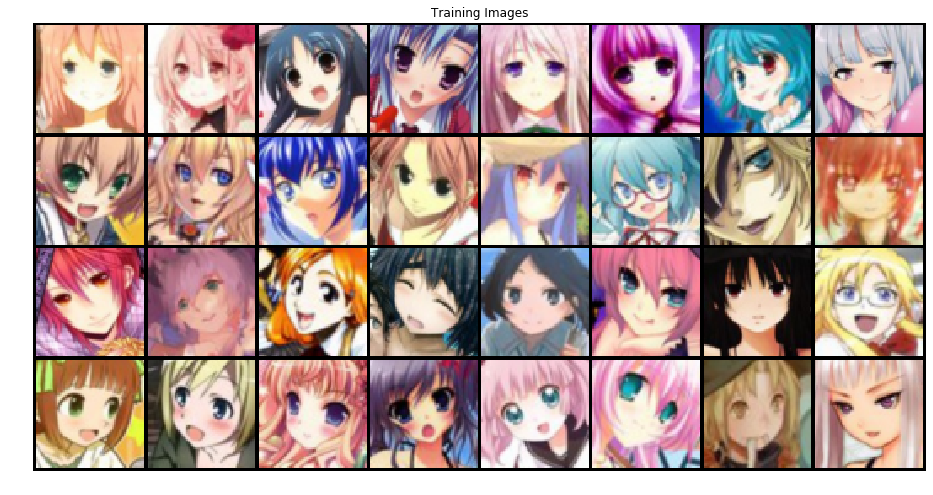

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize(mean=mean, std=std),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(16,16))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# Create the generator
netG = Generator(ngpu, nz, ngf, nc).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [6]:
# Create the Discriminator
netD = Discriminator(ngpu, nc, ndf).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [7]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [8]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
min_loss = 100

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        if min_loss > errG.item():
            min_loss = errG.item()
            torch.save(netG.state_dict(), PATH)

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch + 1, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[1/50][0/1601]	Loss_D: 1.7849	Loss_G: 6.5559	D(x): 0.5178	D(G(z)): 0.5583 / 0.0021
[1/50][50/1601]	Loss_D: 1.8837	Loss_G: 20.1872	D(x): 0.9101	D(G(z)): 0.6312 / 0.0000
[1/50][100/1601]	Loss_D: 0.7416	Loss_G: 5.4787	D(x): 0.8236	D(G(z)): 0.3220 / 0.0098
[1/50][150/1601]	Loss_D: 0.8052	Loss_G: 2.5526	D(x): 0.6838	D(G(z)): 0.0868 / 0.1283
[1/50][200/1601]	Loss_D: 0.5818	Loss_G: 6.8498	D(x): 0.6742	D(G(z)): 0.0087 / 0.0025
[1/50][250/1601]	Loss_D: 0.5561	Loss_G: 4.2902	D(x): 0.7956	D(G(z)): 0.2063 / 0.0388
[1/50][300/1601]	Loss_D: 2.6272	Loss_G: 9.6020	D(x): 0.9579	D(G(z)): 0.8475 / 0.0004
[1/50][350/1601]	Loss_D: 0.4514	Loss_G: 4.0021	D(x): 0.8405	D(G(z)): 0.1912 / 0.0422
[1/50][400/1601]	Loss_D: 0.6459	Loss_G: 5.3953	D(x): 0.8546	D(G(z)): 0.3294 / 0.0074
[1/50][450/1601]	Loss_D: 0.3150	Loss_G: 3.6453	D(x): 0.8478	D(G(z)): 0.0912 / 0.0449
[1/50][500/1601]	Loss_D: 0.9000	Loss_G: 4.7426	D(x): 0.5702	D(G(z)): 0.0190 / 0.0184
[1/50][550/1601]	Loss_D: 1.1529	Loss_G: 6

[3/50][1500/1601]	Loss_D: 0.2278	Loss_G: 5.0154	D(x): 0.9033	D(G(z)): 0.1006 / 0.0107
[3/50][1550/1601]	Loss_D: 0.2869	Loss_G: 3.1955	D(x): 0.8724	D(G(z)): 0.1116 / 0.0725
[3/50][1600/1601]	Loss_D: 0.6204	Loss_G: 5.0886	D(x): 0.8420	D(G(z)): 0.2631 / 0.0090
[4/50][0/1601]	Loss_D: 0.4968	Loss_G: 2.2603	D(x): 0.7037	D(G(z)): 0.0577 / 0.1277
[4/50][50/1601]	Loss_D: 0.3352	Loss_G: 3.3771	D(x): 0.9115	D(G(z)): 0.1423 / 0.0566
[4/50][100/1601]	Loss_D: 0.2738	Loss_G: 3.7193	D(x): 0.9780	D(G(z)): 0.1906 / 0.0376
[4/50][150/1601]	Loss_D: 0.5738	Loss_G: 4.3953	D(x): 0.8226	D(G(z)): 0.2583 / 0.0172
[4/50][200/1601]	Loss_D: 0.5348	Loss_G: 3.6491	D(x): 0.6668	D(G(z)): 0.0107 / 0.0495
[4/50][250/1601]	Loss_D: 0.3548	Loss_G: 4.7779	D(x): 0.8210	D(G(z)): 0.0809 / 0.0177
[4/50][300/1601]	Loss_D: 0.4240	Loss_G: 3.8741	D(x): 0.7358	D(G(z)): 0.0611 / 0.0476
[4/50][350/1601]	Loss_D: 0.4290	Loss_G: 3.5607	D(x): 0.7777	D(G(z)): 0.0941 / 0.0396
[4/50][400/1601]	Loss_D: 0.5385	Loss_G: 1.5554	D(x): 0.6966	D(G(z

[6/50][1400/1601]	Loss_D: 0.3282	Loss_G: 1.9565	D(x): 0.8712	D(G(z)): 0.1431 / 0.1781
[6/50][1450/1601]	Loss_D: 1.6701	Loss_G: 0.9809	D(x): 0.3064	D(G(z)): 0.0190 / 0.4461
[6/50][1500/1601]	Loss_D: 0.3037	Loss_G: 3.8758	D(x): 0.8942	D(G(z)): 0.1519 / 0.0301
[6/50][1550/1601]	Loss_D: 0.5754	Loss_G: 1.0465	D(x): 0.6579	D(G(z)): 0.0490 / 0.4016
[6/50][1600/1601]	Loss_D: 0.5652	Loss_G: 2.5286	D(x): 0.7056	D(G(z)): 0.1502 / 0.1017
[7/50][0/1601]	Loss_D: 0.3875	Loss_G: 5.0761	D(x): 0.9508	D(G(z)): 0.2567 / 0.0092
[7/50][50/1601]	Loss_D: 0.4131	Loss_G: 5.6481	D(x): 0.9070	D(G(z)): 0.2418 / 0.0046
[7/50][100/1601]	Loss_D: 0.6702	Loss_G: 2.8710	D(x): 0.5707	D(G(z)): 0.0117 / 0.0987
[7/50][150/1601]	Loss_D: 0.3595	Loss_G: 3.9206	D(x): 0.8600	D(G(z)): 0.1589 / 0.0289
[7/50][200/1601]	Loss_D: 2.0691	Loss_G: 5.9805	D(x): 0.9611	D(G(z)): 0.7962 / 0.0052
[7/50][250/1601]	Loss_D: 0.8715	Loss_G: 2.1738	D(x): 0.5134	D(G(z)): 0.0102 / 0.1914
[7/50][300/1601]	Loss_D: 1.4522	Loss_G: 4.0189	D(x): 0.9561	D(G

[9/50][1300/1601]	Loss_D: 0.2335	Loss_G: 3.9971	D(x): 0.8617	D(G(z)): 0.0520 / 0.0294
[9/50][1350/1601]	Loss_D: 0.3184	Loss_G: 4.0307	D(x): 0.9380	D(G(z)): 0.1948 / 0.0245
[9/50][1400/1601]	Loss_D: 0.1203	Loss_G: 4.4165	D(x): 0.9371	D(G(z)): 0.0483 / 0.0245
[9/50][1450/1601]	Loss_D: 0.3776	Loss_G: 2.6366	D(x): 0.7893	D(G(z)): 0.1066 / 0.0996
[9/50][1500/1601]	Loss_D: 0.1500	Loss_G: 4.3935	D(x): 0.9214	D(G(z)): 0.0572 / 0.0261
[9/50][1550/1601]	Loss_D: 0.2804	Loss_G: 3.4749	D(x): 0.8524	D(G(z)): 0.0900 / 0.0475
[9/50][1600/1601]	Loss_D: 0.7106	Loss_G: 9.2151	D(x): 0.8935	D(G(z)): 0.3979 / 0.0002
[10/50][0/1601]	Loss_D: 2.7421	Loss_G: 0.2173	D(x): 0.1186	D(G(z)): 0.0022 / 0.8161
[10/50][50/1601]	Loss_D: 0.0878	Loss_G: 3.8892	D(x): 0.9636	D(G(z)): 0.0474 / 0.0325
[10/50][100/1601]	Loss_D: 0.4797	Loss_G: 2.0750	D(x): 0.7205	D(G(z)): 0.0627 / 0.1951
[10/50][150/1601]	Loss_D: 0.2708	Loss_G: 6.6941	D(x): 0.9546	D(G(z)): 0.1524 / 0.0022
[10/50][200/1601]	Loss_D: 0.8635	Loss_G: 10.5713	D(x): 0.

[12/50][1100/1601]	Loss_D: 0.4367	Loss_G: 4.9924	D(x): 0.9672	D(G(z)): 0.2915 / 0.0101
[12/50][1150/1601]	Loss_D: 0.0694	Loss_G: 5.4575	D(x): 0.9973	D(G(z)): 0.0631 / 0.0062
[12/50][1200/1601]	Loss_D: 0.3584	Loss_G: 4.2652	D(x): 0.8686	D(G(z)): 0.1481 / 0.0288
[12/50][1250/1601]	Loss_D: 0.8042	Loss_G: 3.1634	D(x): 0.7637	D(G(z)): 0.3393 / 0.0660
[12/50][1300/1601]	Loss_D: 0.3607	Loss_G: 4.8107	D(x): 0.8758	D(G(z)): 0.1607 / 0.0123
[12/50][1350/1601]	Loss_D: 0.4610	Loss_G: 3.4523	D(x): 0.8045	D(G(z)): 0.1583 / 0.0407
[12/50][1400/1601]	Loss_D: 0.1125	Loss_G: 5.1835	D(x): 0.9935	D(G(z)): 0.0921 / 0.0084
[12/50][1450/1601]	Loss_D: 1.1109	Loss_G: 0.6599	D(x): 0.4609	D(G(z)): 0.0667 / 0.5659
[12/50][1500/1601]	Loss_D: 0.0939	Loss_G: 3.9629	D(x): 0.9463	D(G(z)): 0.0340 / 0.0373
[12/50][1550/1601]	Loss_D: 0.1321	Loss_G: 4.5367	D(x): 0.9021	D(G(z)): 0.0192 / 0.0195
[12/50][1600/1601]	Loss_D: 0.4006	Loss_G: 4.2923	D(x): 0.9626	D(G(z)): 0.2713 / 0.0166
[13/50][0/1601]	Loss_D: 0.6072	Loss_G: 2.72

[15/50][900/1601]	Loss_D: 0.0764	Loss_G: 5.7470	D(x): 0.9352	D(G(z)): 0.0058 / 0.0095
[15/50][950/1601]	Loss_D: 0.3683	Loss_G: 5.5502	D(x): 0.9538	D(G(z)): 0.2387 / 0.0081
[15/50][1000/1601]	Loss_D: 0.4843	Loss_G: 2.7845	D(x): 0.6890	D(G(z)): 0.0355 / 0.1141
[15/50][1050/1601]	Loss_D: 0.4807	Loss_G: 4.6560	D(x): 0.9884	D(G(z)): 0.3082 / 0.0145
[15/50][1100/1601]	Loss_D: 0.1113	Loss_G: 7.4228	D(x): 0.9932	D(G(z)): 0.0918 / 0.0009
[15/50][1150/1601]	Loss_D: 0.4655	Loss_G: 2.6591	D(x): 0.7071	D(G(z)): 0.0464 / 0.1202
[15/50][1200/1601]	Loss_D: 0.5803	Loss_G: 2.3395	D(x): 0.7404	D(G(z)): 0.1690 / 0.1380
[15/50][1250/1601]	Loss_D: 0.1731	Loss_G: 4.2024	D(x): 0.9303	D(G(z)): 0.0795 / 0.0255
[15/50][1300/1601]	Loss_D: 0.2150	Loss_G: 4.7328	D(x): 0.8728	D(G(z)): 0.0578 / 0.0140
[15/50][1350/1601]	Loss_D: 0.3479	Loss_G: 3.2231	D(x): 0.8073	D(G(z)): 0.0874 / 0.0760
[15/50][1400/1601]	Loss_D: 4.6482	Loss_G: 1.4875	D(x): 0.0196	D(G(z)): 0.0004 / 0.3039
[15/50][1450/1601]	Loss_D: 0.8647	Loss_G: 3.6

[18/50][700/1601]	Loss_D: 0.2774	Loss_G: 3.1561	D(x): 0.8458	D(G(z)): 0.0827 / 0.0584
[18/50][750/1601]	Loss_D: 0.1455	Loss_G: 4.2231	D(x): 0.9259	D(G(z)): 0.0580 / 0.0300
[18/50][800/1601]	Loss_D: 0.1858	Loss_G: 4.3728	D(x): 0.9499	D(G(z)): 0.1028 / 0.0182
[18/50][850/1601]	Loss_D: 0.0540	Loss_G: 4.9478	D(x): 0.9748	D(G(z)): 0.0266 / 0.0135
[18/50][900/1601]	Loss_D: 0.4256	Loss_G: 3.6091	D(x): 0.7842	D(G(z)): 0.0735 / 0.0584
[18/50][950/1601]	Loss_D: 0.0235	Loss_G: 5.7826	D(x): 0.9941	D(G(z)): 0.0170 / 0.0070
[18/50][1000/1601]	Loss_D: 0.0207	Loss_G: 5.4488	D(x): 0.9878	D(G(z)): 0.0082 / 0.0078
[18/50][1050/1601]	Loss_D: 0.8578	Loss_G: 6.1910	D(x): 0.9851	D(G(z)): 0.4709 / 0.0032
[18/50][1100/1601]	Loss_D: 0.4819	Loss_G: 5.5363	D(x): 0.9881	D(G(z)): 0.3078 / 0.0068
[18/50][1150/1601]	Loss_D: 0.0159	Loss_G: 5.3567	D(x): 0.9959	D(G(z)): 0.0116 / 0.0071
[18/50][1200/1601]	Loss_D: 0.1367	Loss_G: 5.2739	D(x): 0.8975	D(G(z)): 0.0181 / 0.0095
[18/50][1250/1601]	Loss_D: 2.1572	Loss_G: 1.2248	

[21/50][500/1601]	Loss_D: 0.9625	Loss_G: 0.4904	D(x): 0.5455	D(G(z)): 0.0708 / 0.6805
[21/50][550/1601]	Loss_D: 0.4663	Loss_G: 3.3879	D(x): 0.7267	D(G(z)): 0.0409 / 0.0677
[21/50][600/1601]	Loss_D: 0.1056	Loss_G: 4.2380	D(x): 0.9504	D(G(z)): 0.0467 / 0.0270
[21/50][650/1601]	Loss_D: 0.0447	Loss_G: 5.2459	D(x): 0.9852	D(G(z)): 0.0286 / 0.0107
[21/50][700/1601]	Loss_D: 0.2838	Loss_G: 3.7653	D(x): 0.9347	D(G(z)): 0.1730 / 0.0349
[21/50][750/1601]	Loss_D: 0.1551	Loss_G: 3.6572	D(x): 0.9469	D(G(z)): 0.0811 / 0.0397
[21/50][800/1601]	Loss_D: 0.5762	Loss_G: 5.9447	D(x): 0.9967	D(G(z)): 0.3818 / 0.0045
[21/50][850/1601]	Loss_D: 0.0255	Loss_G: 5.5870	D(x): 0.9947	D(G(z)): 0.0196 / 0.0083
[21/50][900/1601]	Loss_D: 0.0646	Loss_G: 4.8534	D(x): 0.9485	D(G(z)): 0.0082 / 0.0224
[21/50][950/1601]	Loss_D: 0.2796	Loss_G: 5.2746	D(x): 0.9898	D(G(z)): 0.1974 / 0.0121
[21/50][1000/1601]	Loss_D: 0.3602	Loss_G: 4.1167	D(x): 0.8858	D(G(z)): 0.1568 / 0.0246
[21/50][1050/1601]	Loss_D: 0.2480	Loss_G: 4.6855	D(x)

[24/50][300/1601]	Loss_D: 0.1771	Loss_G: 3.9886	D(x): 0.9092	D(G(z)): 0.0664 / 0.0466
[24/50][350/1601]	Loss_D: 0.1796	Loss_G: 5.1864	D(x): 0.9789	D(G(z)): 0.1004 / 0.0086
[24/50][400/1601]	Loss_D: 0.0396	Loss_G: 6.3896	D(x): 0.9863	D(G(z)): 0.0225 / 0.0046
[24/50][450/1601]	Loss_D: 0.1114	Loss_G: 10.1848	D(x): 0.9956	D(G(z)): 0.0952 / 0.0001
[24/50][500/1601]	Loss_D: 0.2409	Loss_G: 4.0400	D(x): 0.9106	D(G(z)): 0.1073 / 0.0332
[24/50][550/1601]	Loss_D: 0.2235	Loss_G: 3.1463	D(x): 0.8809	D(G(z)): 0.0574 / 0.0861
[24/50][600/1601]	Loss_D: 3.3023	Loss_G: 0.0174	D(x): 0.1297	D(G(z)): 0.0029 / 0.9837
[24/50][650/1601]	Loss_D: 0.6174	Loss_G: 3.5001	D(x): 0.6258	D(G(z)): 0.0235 / 0.0782
[24/50][700/1601]	Loss_D: 0.1495	Loss_G: 4.7260	D(x): 0.9450	D(G(z)): 0.0780 / 0.0168
[24/50][750/1601]	Loss_D: 0.0702	Loss_G: 4.9066	D(x): 0.9689	D(G(z)): 0.0277 / 0.0174
[24/50][800/1601]	Loss_D: 0.2605	Loss_G: 4.3797	D(x): 0.9504	D(G(z)): 0.1627 / 0.0174
[24/50][850/1601]	Loss_D: 0.1160	Loss_G: 3.9373	D(x):

[27/50][100/1601]	Loss_D: 0.2037	Loss_G: 5.8578	D(x): 0.9427	D(G(z)): 0.0908 / 0.0076
[27/50][150/1601]	Loss_D: 0.0550	Loss_G: 6.3381	D(x): 0.9665	D(G(z)): 0.0194 / 0.0045
[27/50][200/1601]	Loss_D: 0.0975	Loss_G: 8.4568	D(x): 0.9978	D(G(z)): 0.0811 / 0.0004
[27/50][250/1601]	Loss_D: 0.2199	Loss_G: 3.3865	D(x): 0.9281	D(G(z)): 0.1158 / 0.0496
[27/50][300/1601]	Loss_D: 0.2024	Loss_G: 4.6279	D(x): 0.8937	D(G(z)): 0.0570 / 0.0216
[27/50][350/1601]	Loss_D: 0.0245	Loss_G: 5.9393	D(x): 0.9969	D(G(z)): 0.0200 / 0.0059
[27/50][400/1601]	Loss_D: 0.0150	Loss_G: 5.8005	D(x): 0.9996	D(G(z)): 0.0143 / 0.0070
[27/50][450/1601]	Loss_D: 0.1996	Loss_G: 4.9290	D(x): 0.8501	D(G(z)): 0.0058 / 0.0197
[27/50][500/1601]	Loss_D: 0.1651	Loss_G: 5.5525	D(x): 0.9459	D(G(z)): 0.0888 / 0.0074
[27/50][550/1601]	Loss_D: 0.0423	Loss_G: 5.3846	D(x): 0.9904	D(G(z)): 0.0310 / 0.0103
[27/50][600/1601]	Loss_D: 0.0922	Loss_G: 5.2520	D(x): 0.9345	D(G(z)): 0.0182 / 0.0153
[27/50][650/1601]	Loss_D: 0.0096	Loss_G: 6.0435	D(x): 

[29/50][1550/1601]	Loss_D: 0.0567	Loss_G: 4.8673	D(x): 0.9907	D(G(z)): 0.0441 / 0.0237
[29/50][1600/1601]	Loss_D: 1.6615	Loss_G: 1.3009	D(x): 0.2855	D(G(z)): 0.0050 / 0.4108
[30/50][0/1601]	Loss_D: 1.1937	Loss_G: 10.1652	D(x): 0.9988	D(G(z)): 0.6000 / 0.0001
[30/50][50/1601]	Loss_D: 0.6132	Loss_G: 6.5940	D(x): 0.9238	D(G(z)): 0.3242 / 0.0030
[30/50][100/1601]	Loss_D: 0.1029	Loss_G: 5.4099	D(x): 0.9488	D(G(z)): 0.0417 / 0.0168
[30/50][150/1601]	Loss_D: 0.1037	Loss_G: 5.9379	D(x): 0.9379	D(G(z)): 0.0239 / 0.0094
[30/50][200/1601]	Loss_D: 0.0327	Loss_G: 5.5902	D(x): 0.9974	D(G(z)): 0.0283 / 0.0073
[30/50][250/1601]	Loss_D: 0.5308	Loss_G: 4.9273	D(x): 0.6511	D(G(z)): 0.0030 / 0.0260
[30/50][300/1601]	Loss_D: 0.3555	Loss_G: 4.7095	D(x): 0.9289	D(G(z)): 0.2013 / 0.0129
[30/50][350/1601]	Loss_D: 0.0801	Loss_G: 6.5298	D(x): 0.9934	D(G(z)): 0.0649 / 0.0030
[30/50][400/1601]	Loss_D: 0.1594	Loss_G: 4.0001	D(x): 0.8827	D(G(z)): 0.0203 / 0.0291
[30/50][450/1601]	Loss_D: 0.1524	Loss_G: 5.0235	D(x): 

[32/50][1350/1601]	Loss_D: 0.1660	Loss_G: 3.7204	D(x): 0.9475	D(G(z)): 0.0879 / 0.0405
[32/50][1400/1601]	Loss_D: 0.0686	Loss_G: 4.8155	D(x): 0.9524	D(G(z)): 0.0170 / 0.0189
[32/50][1450/1601]	Loss_D: 0.0401	Loss_G: 3.5685	D(x): 0.9975	D(G(z)): 0.0357 / 0.0537
[32/50][1500/1601]	Loss_D: 0.8331	Loss_G: 4.9480	D(x): 0.9380	D(G(z)): 0.4127 / 0.0282
[32/50][1550/1601]	Loss_D: 0.0713	Loss_G: 5.0963	D(x): 0.9737	D(G(z)): 0.0392 / 0.0140
[32/50][1600/1601]	Loss_D: 0.1586	Loss_G: 6.1015	D(x): 0.9019	D(G(z)): 0.0024 / 0.0049
[33/50][0/1601]	Loss_D: 0.0190	Loss_G: 5.1962	D(x): 0.9994	D(G(z)): 0.0179 / 0.0091
[33/50][50/1601]	Loss_D: 0.1493	Loss_G: 5.0336	D(x): 0.9681	D(G(z)): 0.0863 / 0.0157
[33/50][100/1601]	Loss_D: 0.0731	Loss_G: 4.6040	D(x): 0.9655	D(G(z)): 0.0354 / 0.0226
[33/50][150/1601]	Loss_D: 0.0889	Loss_G: 5.6819	D(x): 0.9325	D(G(z)): 0.0138 / 0.0115
[33/50][200/1601]	Loss_D: 0.1729	Loss_G: 3.6176	D(x): 0.8673	D(G(z)): 0.0148 / 0.0555
[33/50][250/1601]	Loss_D: 0.0688	Loss_G: 5.6802	D(x

[35/50][1150/1601]	Loss_D: 0.0631	Loss_G: 5.6451	D(x): 0.9751	D(G(z)): 0.0347 / 0.0139
[35/50][1200/1601]	Loss_D: 0.1975	Loss_G: 3.9469	D(x): 0.8526	D(G(z)): 0.0135 / 0.0547
[35/50][1250/1601]	Loss_D: 0.0928	Loss_G: 5.3617	D(x): 0.9931	D(G(z)): 0.0688 / 0.0098
[35/50][1300/1601]	Loss_D: 0.0933	Loss_G: 5.2793	D(x): 0.9329	D(G(z)): 0.0126 / 0.0144
[35/50][1350/1601]	Loss_D: 0.0487	Loss_G: 5.5100	D(x): 0.9932	D(G(z)): 0.0376 / 0.0090
[35/50][1400/1601]	Loss_D: 1.2674	Loss_G: 2.0290	D(x): 0.4268	D(G(z)): 0.0197 / 0.2423
[35/50][1450/1601]	Loss_D: 0.1177	Loss_G: 5.6096	D(x): 0.9873	D(G(z)): 0.0834 / 0.0063
[35/50][1500/1601]	Loss_D: 0.2472	Loss_G: 8.3844	D(x): 0.9982	D(G(z)): 0.1651 / 0.0004
[35/50][1550/1601]	Loss_D: 0.2281	Loss_G: 4.9210	D(x): 0.8410	D(G(z)): 0.0058 / 0.0200
[35/50][1600/1601]	Loss_D: 0.0186	Loss_G: 6.3914	D(x): 0.9930	D(G(z)): 0.0113 / 0.0049
[36/50][0/1601]	Loss_D: 0.0208	Loss_G: 6.4880	D(x): 0.9968	D(G(z)): 0.0169 / 0.0042
[36/50][50/1601]	Loss_D: 0.0976	Loss_G: 2.2339

[38/50][950/1601]	Loss_D: 0.1034	Loss_G: 5.5767	D(x): 0.9813	D(G(z)): 0.0731 / 0.0111
[38/50][1000/1601]	Loss_D: 0.0565	Loss_G: 6.5004	D(x): 0.9544	D(G(z)): 0.0080 / 0.0068
[38/50][1050/1601]	Loss_D: 0.0991	Loss_G: 5.0661	D(x): 0.9705	D(G(z)): 0.0561 / 0.0106
[38/50][1100/1601]	Loss_D: 0.0296	Loss_G: 6.6755	D(x): 0.9967	D(G(z)): 0.0252 / 0.0045
[38/50][1150/1601]	Loss_D: 0.0947	Loss_G: 5.3457	D(x): 0.9558	D(G(z)): 0.0382 / 0.0150
[38/50][1200/1601]	Loss_D: 0.1837	Loss_G: 4.7264	D(x): 0.9838	D(G(z)): 0.1332 / 0.0169
[38/50][1250/1601]	Loss_D: 0.0295	Loss_G: 5.8706	D(x): 0.9849	D(G(z)): 0.0136 / 0.0065
[38/50][1300/1601]	Loss_D: 0.0131	Loss_G: 6.7706	D(x): 0.9970	D(G(z)): 0.0097 / 0.0049
[38/50][1350/1601]	Loss_D: 0.1005	Loss_G: 6.0284	D(x): 0.9579	D(G(z)): 0.0504 / 0.0049
[38/50][1400/1601]	Loss_D: 0.1479	Loss_G: 5.6764	D(x): 0.9673	D(G(z)): 0.0938 / 0.0087
[38/50][1450/1601]	Loss_D: 0.0187	Loss_G: 6.3193	D(x): 0.9942	D(G(z)): 0.0122 / 0.0050
[38/50][1500/1601]	Loss_D: 0.0082	Loss_G: 7.

[41/50][750/1601]	Loss_D: 0.0930	Loss_G: 4.2196	D(x): 0.9510	D(G(z)): 0.0370 / 0.0273
[41/50][800/1601]	Loss_D: 0.0396	Loss_G: 5.9891	D(x): 0.9783	D(G(z)): 0.0167 / 0.0069
[41/50][850/1601]	Loss_D: 0.0376	Loss_G: 4.3442	D(x): 0.9929	D(G(z)): 0.0291 / 0.0241
[41/50][900/1601]	Loss_D: 0.0511	Loss_G: 4.2216	D(x): 0.9639	D(G(z)): 0.0119 / 0.0456
[41/50][950/1601]	Loss_D: 0.2005	Loss_G: 6.1706	D(x): 0.9666	D(G(z)): 0.1118 / 0.0082
[41/50][1000/1601]	Loss_D: 0.0074	Loss_G: 6.6615	D(x): 0.9995	D(G(z)): 0.0068 / 0.0054
[41/50][1050/1601]	Loss_D: 5.2878	Loss_G: 13.3262	D(x): 0.9999	D(G(z)): 0.9861 / 0.0000
[41/50][1100/1601]	Loss_D: 0.3226	Loss_G: 3.3567	D(x): 0.8361	D(G(z)): 0.0860 / 0.0652
[41/50][1150/1601]	Loss_D: 0.3232	Loss_G: 3.1751	D(x): 0.7992	D(G(z)): 0.0302 / 0.1556
[41/50][1200/1601]	Loss_D: 0.4733	Loss_G: 1.4959	D(x): 0.7060	D(G(z)): 0.0160 / 0.3634
[41/50][1250/1601]	Loss_D: 0.0486	Loss_G: 5.2572	D(x): 0.9718	D(G(z)): 0.0181 / 0.0236
[41/50][1300/1601]	Loss_D: 0.0579	Loss_G: 5.725

[44/50][550/1601]	Loss_D: 0.0000	Loss_G: 65.1536	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][600/1601]	Loss_D: 0.0000	Loss_G: 65.0911	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][650/1601]	Loss_D: 0.0000	Loss_G: 64.9958	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][700/1601]	Loss_D: 0.0000	Loss_G: 65.0270	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][750/1601]	Loss_D: 0.0000	Loss_G: 65.0879	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][800/1601]	Loss_D: 0.0000	Loss_G: 65.0902	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][850/1601]	Loss_D: 0.0000	Loss_G: 65.1719	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][900/1601]	Loss_D: 0.0000	Loss_G: 65.2836	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][950/1601]	Loss_D: 0.0000	Loss_G: 65.2069	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][1000/1601]	Loss_D: 0.0000	Loss_G: 65.1578	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][1050/1601]	Loss_D: 0.0000	Loss_G: 64.8627	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[44/50][1100/1601]	Loss_D: 0.0000	Loss_G:

[47/50][300/1601]	Loss_D: 0.0000	Loss_G: 64.5752	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][350/1601]	Loss_D: 0.0000	Loss_G: 64.0400	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][400/1601]	Loss_D: 0.0000	Loss_G: 64.7779	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][450/1601]	Loss_D: 0.0000	Loss_G: 64.0793	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][500/1601]	Loss_D: 0.0000	Loss_G: 65.0102	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][550/1601]	Loss_D: 0.0000	Loss_G: 64.5893	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][600/1601]	Loss_D: 0.0000	Loss_G: 64.6144	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][650/1601]	Loss_D: 0.0000	Loss_G: 64.7945	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][700/1601]	Loss_D: 0.0000	Loss_G: 64.8125	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][750/1601]	Loss_D: 0.0000	Loss_G: 64.6625	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][800/1601]	Loss_D: 0.0000	Loss_G: 64.3270	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/50][850/1601]	Loss_D: 0.0000	Loss_G: 64

[50/50][50/1601]	Loss_D: 0.0000	Loss_G: 64.3134	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][100/1601]	Loss_D: 0.0000	Loss_G: 64.1801	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][150/1601]	Loss_D: 0.0000	Loss_G: 64.0717	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][200/1601]	Loss_D: 0.0000	Loss_G: 64.4220	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][250/1601]	Loss_D: 0.0000	Loss_G: 64.4537	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][300/1601]	Loss_D: 0.0000	Loss_G: 64.1117	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][350/1601]	Loss_D: 0.0000	Loss_G: 64.3462	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][400/1601]	Loss_D: 0.0000	Loss_G: 64.1814	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][450/1601]	Loss_D: 0.0000	Loss_G: 64.5106	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][500/1601]	Loss_D: 0.0000	Loss_G: 64.3917	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][550/1601]	Loss_D: 0.0000	Loss_G: 64.3347	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/50][600/1601]	Loss_D: 0.0000	Loss_G: 63.

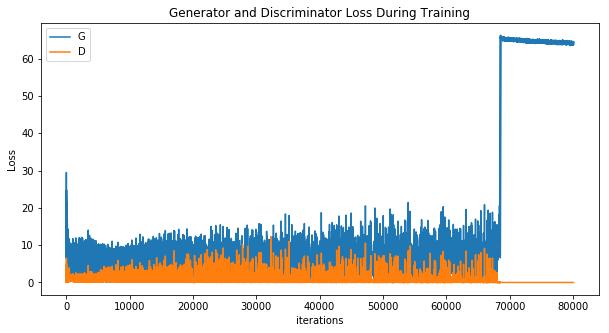

In [9]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21093210 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


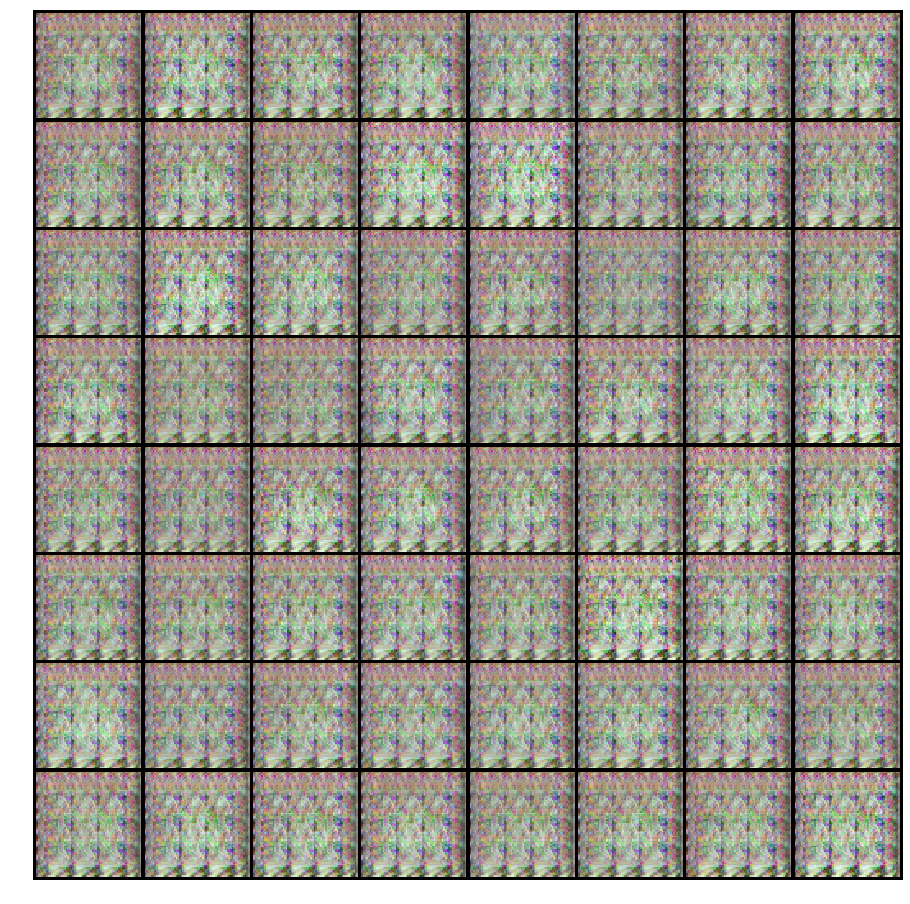

In [10]:
#%%capture
fig = plt.figure(figsize=(16,16))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())